In [7]:
import json
import pandas as pd
from tqdm import tqdm
from vgg16 import Vgg16
import numpy as np
import PIL.Image
from utils import *
from matplotlib import pyplot as plt
import cv2
import os
import cPickle as pickle
from keras.preprocessing import sequence

import shutil
import string

import collections
import nltk
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import stopwords

import re
from numpy.random import random, permutation, randn, normal
from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation, Flatten,Lambda
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,LSTM,TimeDistributed,RepeatVector,Merge
from keras.optimizers import SGD, RMSprop, Adam

import preprocessor as preproc

In [2]:
def save_array_with_folder_create(folder_path,arr_name,arr):
    if not os.path.exists(folder_path):
        print("Creating folder: "+folder_path)
        os.makedirs(folder_path)
        
    save_array(folder_path + arr_name, arr)
    
def load_vectors(loc):
    return (load_array(loc+'.dat'),
        pickle.load(open(loc+'_words.pkl','rb')),
        pickle.load(open(loc+'_idx.pkl','rb')))   




def create_emb(vecs,words,wordidx,index2word,vocab_size):
    n_fact = vecs.shape[1]
    emb = np.zeros((vocab_size, n_fact))

    found = 0
    not_found = 0
    
    exclude = set(string.punctuation)
    for i in range(1,len(emb)):
        word = index2word[i]
        word = ''.join(ch for ch in word if ch not in exclude).lower()
        if word and re.match(r"^[a-zA-Z0-9\-]*$", word) and word in wordidx:
            src_idx = wordidx[word]
            emb[i] = vecs[src_idx]
            found +=1
        else:
            # If we can't find the word in glove, randomly initialize
            emb[i] = normal(scale=0.6, size=(n_fact,))
            not_found+=1
#             print(word)

    # This is our "rare word" id - we want to randomly initialize
    emb[-1] = normal(scale=0.6, size=(n_fact,))
    emb/=3
    
    print("Found = %d"%found)
    print("Not found = %d"%not_found)
        
    return emb

In [3]:
current_folder = train_folder
# current_folder = val_folder

save_path = "/home/docker/fastai-courses/deeplearning1/nbs/persistent/vqa/data/"
path = save_path+"first-try/"
base_path = path + current_folder

In [58]:
unique_words = preproc.load_obj(path+general_datastruct_folder+"unique_words")
word2index = preproc.load_obj(path+general_datastruct_folder+"word2index")
index2word = preproc.load_obj(path+general_datastruct_folder+"index2word")

index2Answer = preproc.load_obj(path+general_datastruct_folder+"index2Answer")

VOCAB_SIZE = len(unique_words)
print(len(unique_words))

4469


In [9]:
MAX_QUESTION_LENGTH  = 10

In [10]:
BATCH_SIZE = 2048

In [11]:
NR_TOP_ANSWERS = 1000

# Train Model

In [12]:
EMB_SIZE = 300
vecs, words, wordidx = load_vectors("/home/docker/fastai-courses/deeplearning1/nbs/persistent/coco/glove/"+"6B."+str(EMB_SIZE)+"d")
emb = create_emb(vecs, words, wordidx,index2word,VOCAB_SIZE)

Found = 4416
Not found = 52


In [13]:
image_model = Sequential()
image_model.add(Dropout(0.1,input_shape=(4096,)))

In [14]:
language_model = Sequential()
language_model.add(Embedding(VOCAB_SIZE, 300, input_length=MAX_QUESTION_LENGTH,weights=[emb]))
language_model.add(GRU(output_dim = 512))

In [15]:
model = Sequential()
model.add(Merge([image_model,language_model], mode='concat', concat_axis=1))
model.add(Dense(1024, activation = "relu"))
model.add(Dropout(0.5))
model.add(Dense(1024, activation = "relu"))
model.add(Dropout(0.5))
model.add(Dense(NR_TOP_ANSWERS))
model.add(Activation('softmax'))

model.compile(loss='categorical_crossentropy', optimizer='adam')

In [16]:
# model.summary()

In [29]:
vgg_folder = "img-vgg/"
indexed_questions_folder = "indexed-questions/"

In [32]:
def generate_from_path():
    
    vgg_dir = base_path + batch_folder + vgg_folder    
    indexed_questions_dir = base_path + batch_folder + indexed_questions_folder
    answers_dir = base_path + batch_folder + answers_folder

    vgg_paths = os.listdir(vgg_dir)
    indexed_questions_paths = os.listdir(indexed_questions_dir)
    answers_paths = os.listdir(answers_dir)
    
    vgg_paths.sort()
    indexed_questions_paths.sort()
    answers_paths.sort()
    
    nr_batches = len(vgg_paths)
    
    while(1):
    
        for batch_index in range(nr_batches):
            vgg_batch = load_array(vgg_dir + vgg_paths[batch_index])
            indexed_questions_batch = load_array(indexed_questions_dir + indexed_questions_paths[batch_index])
            answers_batch = load_array(answers_dir + answers_paths[batch_index])
        
            yield([vgg_batch,indexed_questions_batch],answers_batch)

In [33]:
model.fit_generator(generate_from_path(),
                    samples_per_epoch = 2048,
                    nb_epoch = 100)

Epoch 1/100
2048/2048 [==============================] - 0s - loss: 0.3250
Epoch 2/100
2048/2048 [==============================] - 0s - loss: 0.3649
Epoch 3/100
2048/2048 [==============================] - 0s - loss: 0.3250
Epoch 4/100
2048/2048 [==============================] - 0s - loss: 0.3871
Epoch 5/100
2048/2048 [==============================] - 0s - loss: 0.3080
Epoch 6/100
2048/2048 [==============================] - 0s - loss: 0.3594
Epoch 7/100
2048/2048 [==============================] - 0s - loss: 0.3170
Epoch 8/100
2048/2048 [==============================] - 0s - loss: 0.3692
Epoch 9/100
2048/2048 [==============================] - 0s - loss: 0.3395
Epoch 10/100
2048/2048 [==============================] - 0s - loss: 0.3762
Epoch 11/100
2048/2048 [==============================] - 0s - loss: 0.3027
Epoch 12/100
2048/2048 [==============================] - 0s - loss: 0.3568
Epoch 13/100
2048/2048 [==============================] - 0s - loss: 0.3064
Epoch 14/100
2048/204

## Testing

In [112]:
test_base_path = path + val_folder

In [121]:
image_dir = test_base_path + batch_folder + images_folder     
vgg_dir = test_base_path + batch_folder + vgg_folder    
indexed_questions_dir = test_base_path + batch_folder + indexed_questions_folder
questions_dir = test_base_path + batch_folder + questions_folder
answers_dir = test_base_path + batch_folder + answers_folder

image_paths = os.listdir(image_dir)
vgg_paths = os.listdir(vgg_dir)
indexed_questions_paths = os.listdir(indexed_questions_dir)
questions_paths = os.listdir(questions_dir)
answers_paths = os.listdir(answers_dir)

image_paths.sort()
vgg_paths.sort()
indexed_questions_paths.sort()
questions_paths.sort()
answers_paths.sort()


nr_batches = len(vgg_paths)
nr_batches

2

In [122]:
batch_index = 1
nr_instances = 150

In [123]:
image_batch = load_array(image_dir + image_paths[batch_index])[:nr_instances]
vgg_batch = load_array(vgg_dir + vgg_paths[batch_index])[:nr_instances]
indexed_questions_batch = load_array(indexed_questions_dir + indexed_questions_paths[batch_index])[:nr_instances]
questions_batch = load_array(questions_dir + questions_paths[batch_index])[:nr_instances]
answers_batch = load_array(answers_dir + answers_paths[batch_index])[:nr_instances]


In [124]:
def plot_predictions(ims, titles = None):  
    for i in range(len(ims)):
        if(titles):
            plt.title(titles[i])
        
        img = ims[i]
        blue = img[0:1,...]
        green = img[1:2,...]
        red = img[2:3,...]
        
        img = np.concatenate([red,green,blue])
        
        img = np.transpose(img,(1,2,0))
        plt.imshow(img)
        plt.figure()
            
    plt.show()

In [125]:
predicted_answers_batch = model.predict([vgg_batch,indexed_questions_batch])

In [126]:
real_answers = [index2Answer[np.argmax(indexed_answer)] for indexed_answer in answers_batch]
predicted_answers = [index2Answer[np.argmax(indexed_answer)] for indexed_answer in predicted_answers_batch]

In [127]:
q2a = [str(q) + " ==> "+str(a) + " /// " + str(p)for (q,a,p) in zip(list(questions_batch),list(real_answers), list(predicted_answers))]

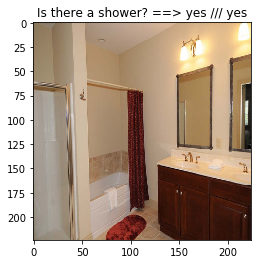

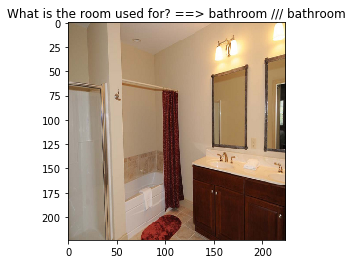

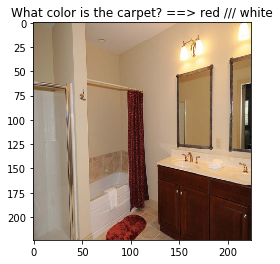

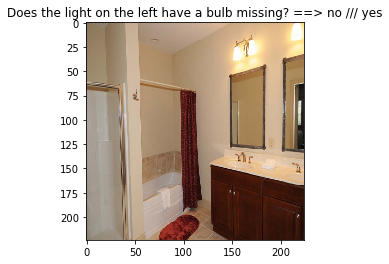

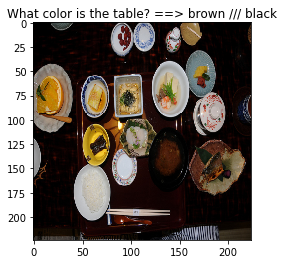

...

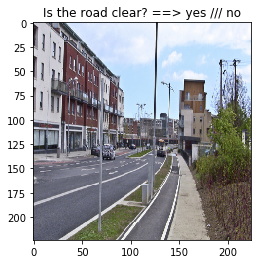

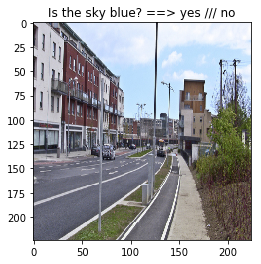

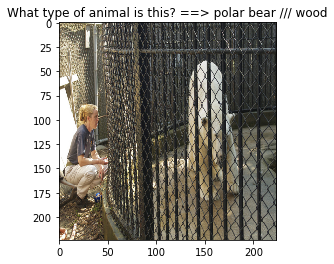

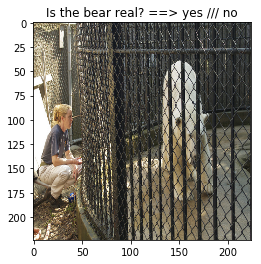

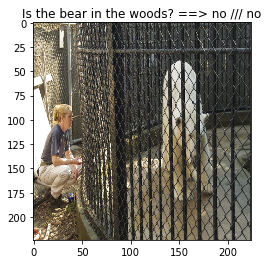

In [128]:
plot_predictions(image_batch,list(q2a))